In [ ]:
from astropy.io import fits
import numpy as np
import matplotlib.pyplot as plt
import sys
import os
from astropy.stats import mad_std
from photutils.aperture import CircularAperture, aperture_photometry
from astropy.visualization import simple_norm
from astropy.stats import mad_std
from photutils.background import Background2D, MedianBackground
import pandas as pd
from astropy.visualization import ZScaleInterval, ImageNormalize
from photutils.detection import DAOStarFinder
from photutils.background import Background2D, MedianBackground
from astropy.stats import sigma_clipped_stats
from astropy.stats import SigmaClip
from astropy.coordinates import SkyCoord
import astropy.units as u
from astropy.wcs import WCS
from astropy.wcs import Sip

In [ ]:
import cv2
# Function to find exact center from approximate ones
def findRealCenter(image,x,y,ds=50,threshold=0.9):#x,y-> approx x,y ; ds-> crop distance from center x,y
  x_start, x_end = int(x)-ds,int(x)+ds
  y_start, y_end = int(y)-ds,int(y)+ds
  # Crop the image
  cropped_image = image[y_start:y_end, x_start:x_end]
  binary_image = cropped_image > threshold
  if not isinstance(binary_image, np.ndarray):
    raise ValueError("The input image is not a NumPy array.")

  # Find contours
  contours, _ = cv2.findContours(binary_image.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  # Find the largest contour
  try:
    largest_contour = max(contours, key=cv2.contourArea)
  except:
    return x,y
  # Calculate centroid of the largest contour
  M = cv2.moments(largest_contour)
  centroid_x = int(M["m10"] / M["m00"])
  centroid_y = int(M["m01"] / M["m00"])

  plt.scatter([ds],[ds],color='red', label="Approx Center")
  plt.scatter([centroid_x],[centroid_y],color='green', label="Actual Center")
  plt.legend()
  plt.imshow(cropped_image, cmap='gray')
  plt.title("Deviation calculation from Center")
  plt.show()
  deviationX = centroid_x-ds
  deviationY = centroid_y-ds
  RealX = x + deviationX
  RealY = y + deviationY
  return RealX,RealY

def deg_to_hms_ra(ra_deg):
    ra_hour = ra_deg / 15.0  # Convert degrees to hours
    ra_hour = ra_hour % 24.0  # Ensure RA is within 0-24 hours

    hours = int(ra_hour)
    minutes = int((ra_hour - hours) * 60)
    seconds = ((ra_hour - hours) * 60 - minutes) * 60

    return f"{hours:02d}:{minutes:02d}:{seconds:.2f}"

def deg_to_dms_dec(dec_deg):
    dec_sign = '+' if dec_deg >= 0 else '-'
    dec_deg = abs(dec_deg)

    degrees = int(dec_deg)
    minutes = int((dec_deg - degrees) * 60)
    seconds = ((dec_deg - degrees) * 60 - minutes) * 60

    return f"{dec_sign}{degrees:02d}:{minutes:02d}:{seconds:.2f}"

def hms_to_deg_ra(ra_hms):
    hours, minutes, seconds = map(float, ra_hms.split(':'))
    ra_deg = (hours + minutes / 60.0 + seconds / 3600.0) * 15.0
    return ra_deg

def dms_to_deg_dec(dec_dms):
    sign, degrees, minutes, seconds = dec_dms[0], *map(float, dec_dms[1:].split(':'))
    dec_deg = (degrees + minutes / 60.0 + seconds / 3600.0)
    return dec_deg if sign == '+' else -dec_deg

# List the fits files in the subdirectory



In [ ]:
dir = "../Data/VestaData"
files = os.listdir(dir)
files10 = [f for f in files if f.endswith('-10.fit')]
files30 = [f for f in files if f.endswith('-30.fit')]

files10.sort()
files30.sort()

def printFiles(files):
    for i in range(len(files)):
        print(str(i) + " " + files[i])

printFiles(files10)
printFiles(files30)

0 Copy of vesta-0831-10.fit
1 Copy of vesta-0835-10.fit
2 Copy of vesta-0838-10.fit
3 Copy of vesta-0841-10.fit
4 Copy of vesta-0844-10.fit
5 Copy of vesta-0847-10.fit
6 Copy of vesta-0850-10.fit
7 Copy of vesta-0853-10.fit
8 Copy of vesta-0858-10.fit
0 Copy of vesta-0758-30.fit
1 Copy of vesta-0803-30.fit
2 Copy of vesta-0808-30.fit
3 Copy of vesta-0813-30.fit
4 Copy of vesta-0818-30.fit
5 Copy of vesta-0823-30.fit
6 Copy of vesta-0828-30.fit
7 Copy of vesta-0833-30.fit


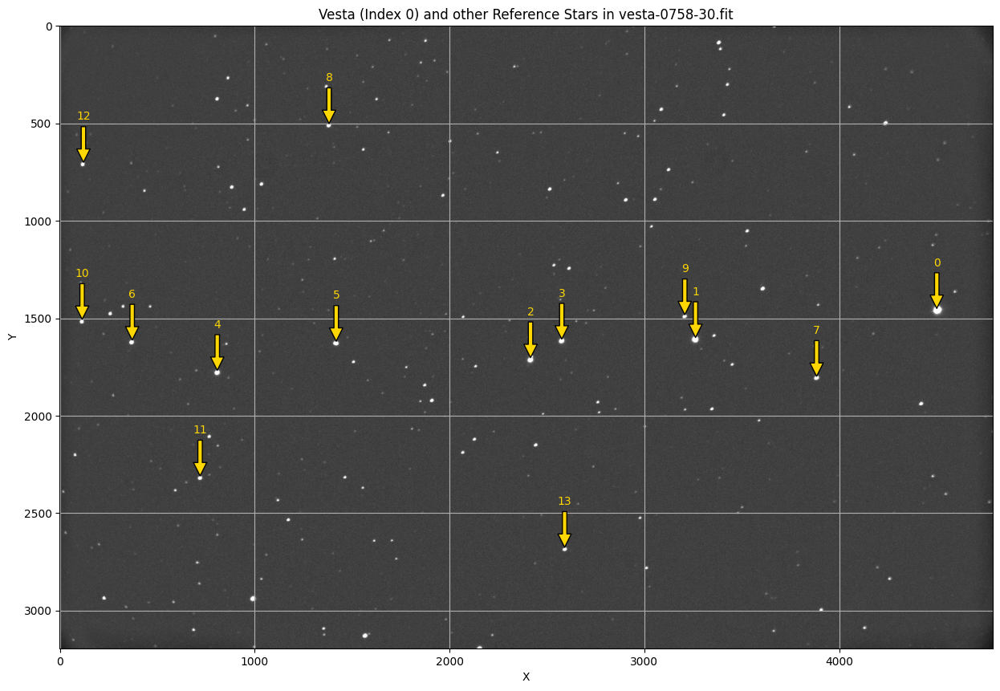

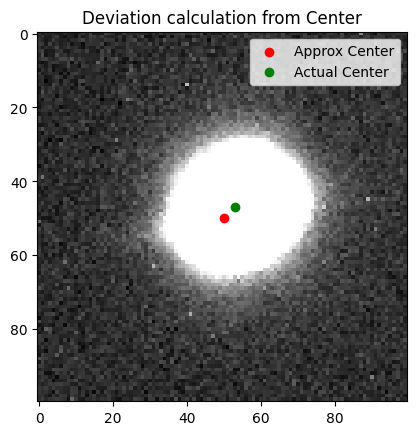

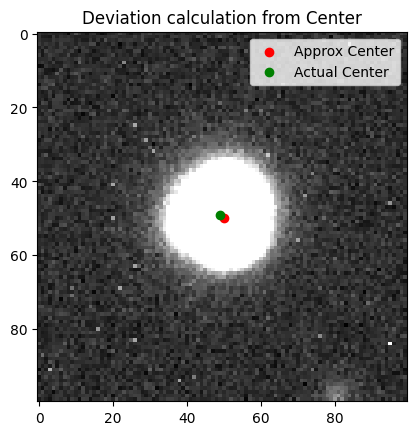

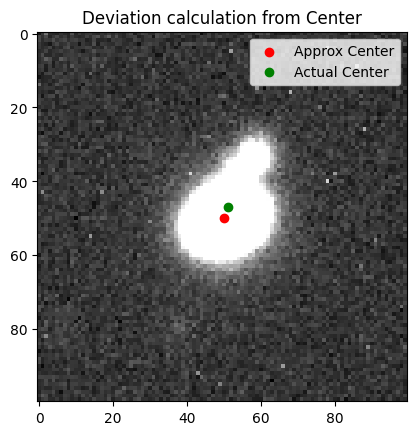

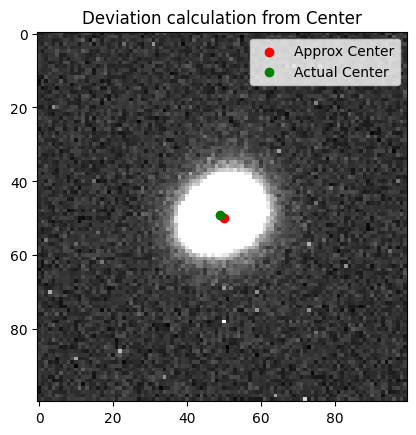

...

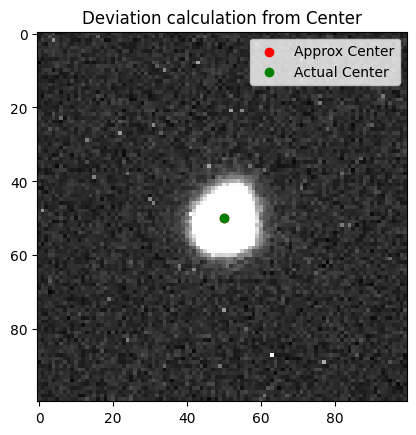

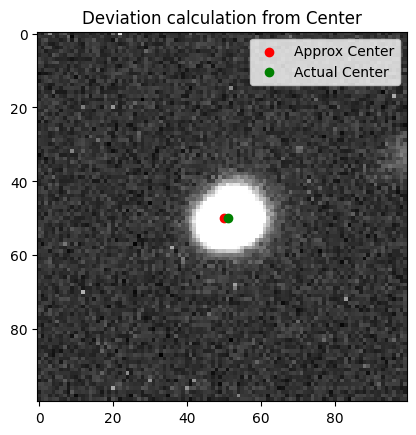

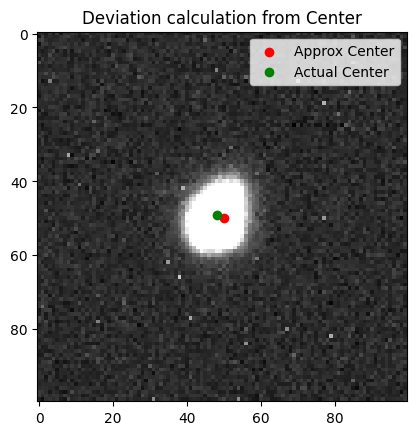

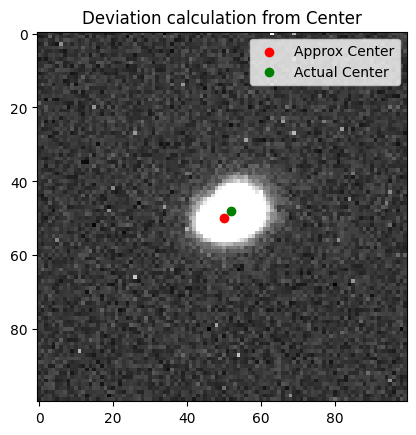

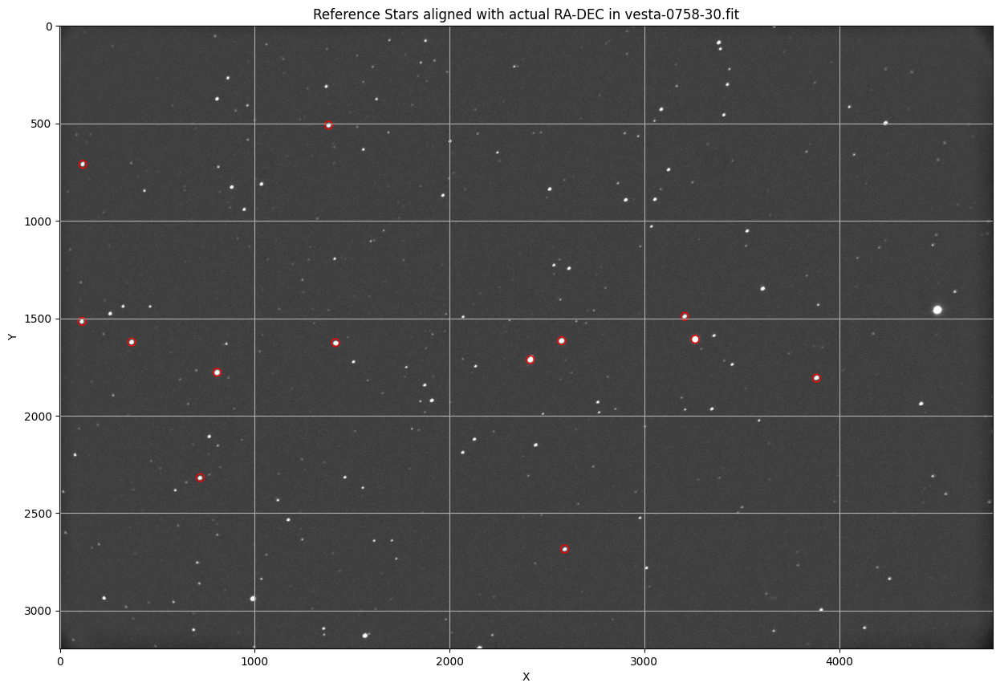

At Time 0758:
RA Vesta = 05:39:36.74
DEC Vesta = +24:00:41.04


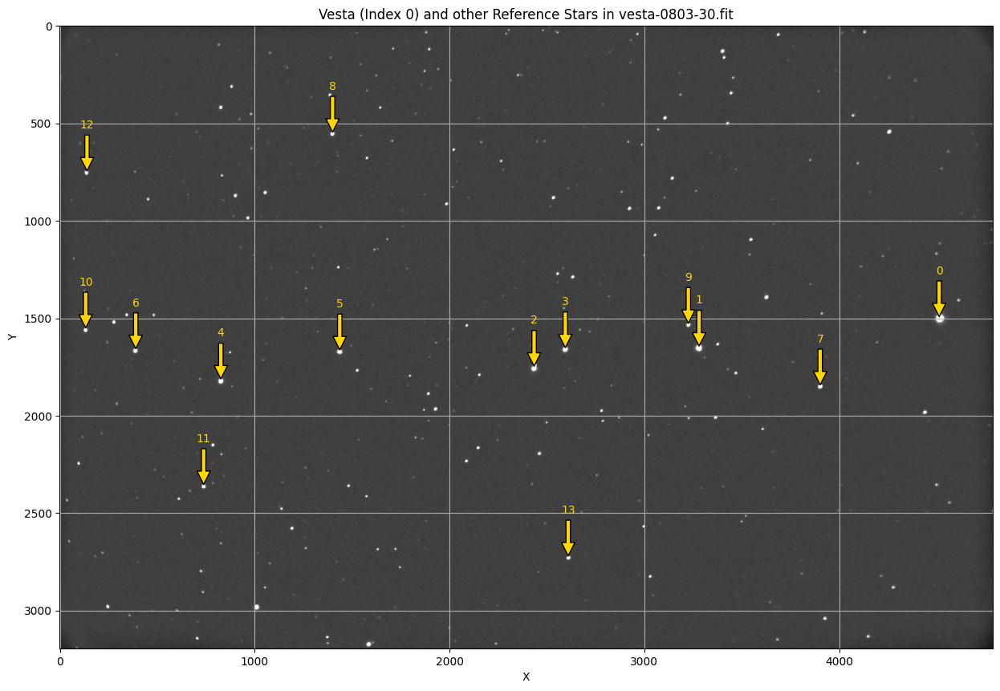

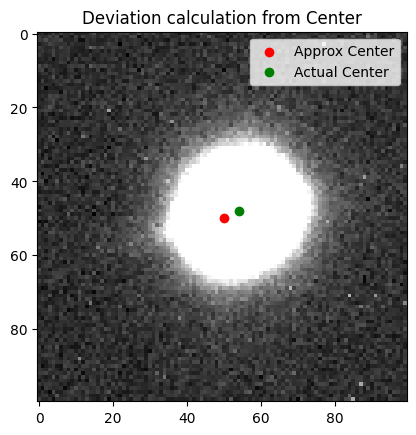

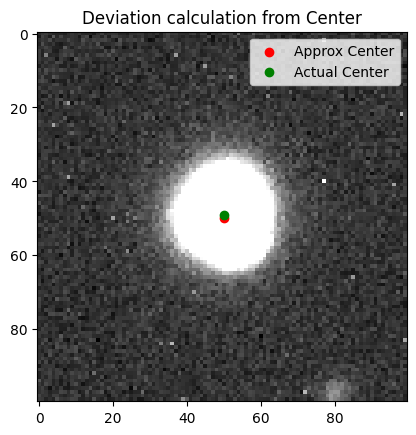

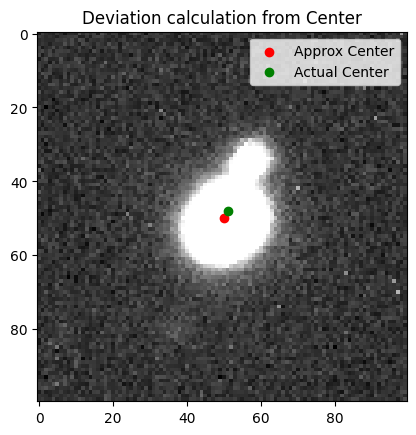

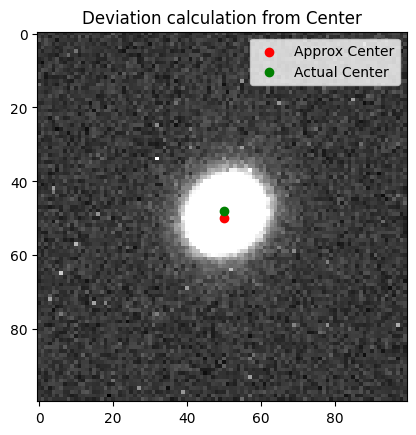

...

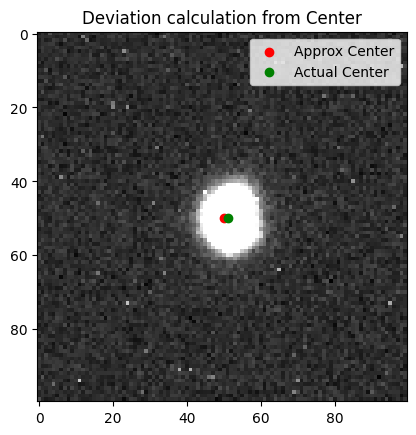

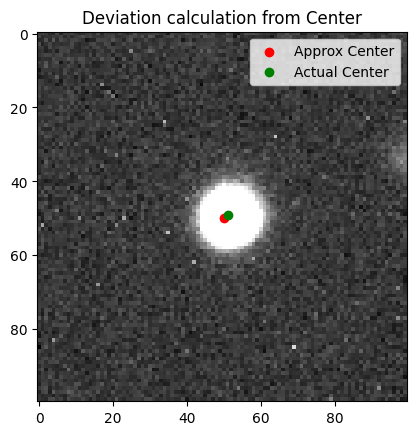

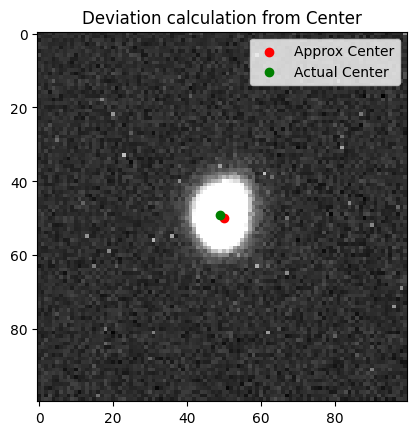

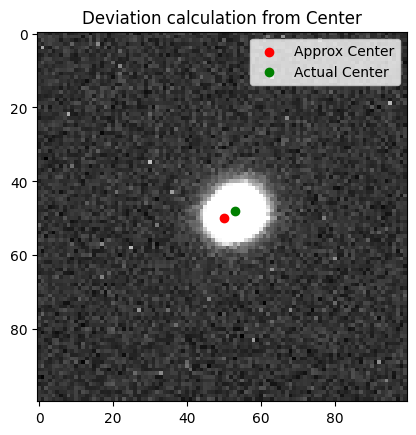

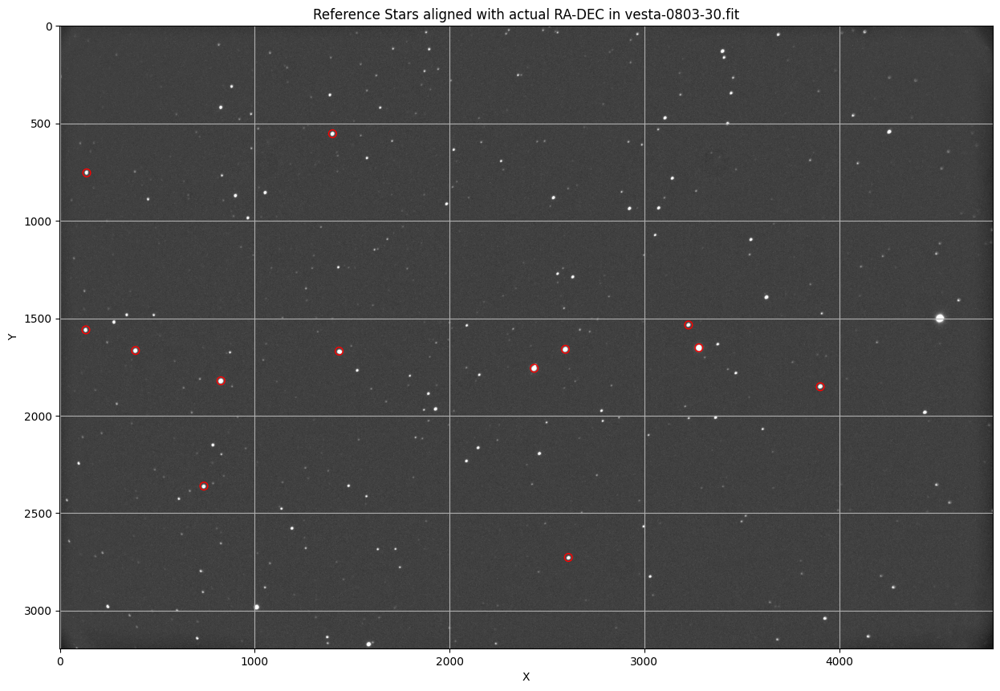

At Time 0803:
RA Vesta = 05:39:36.90
DEC Vesta = +24:00:41.35


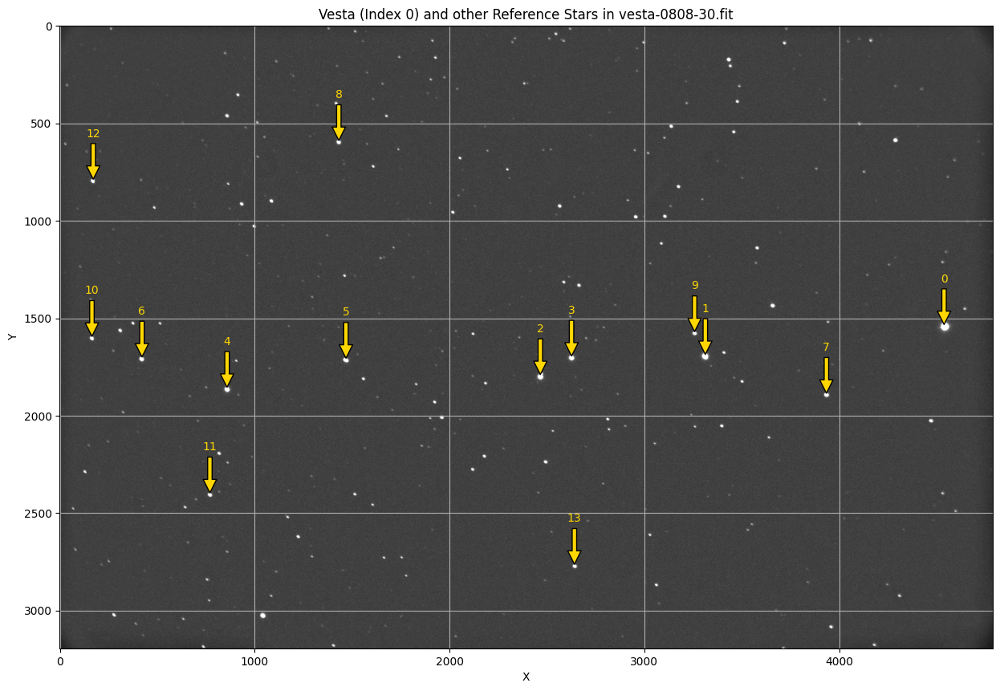

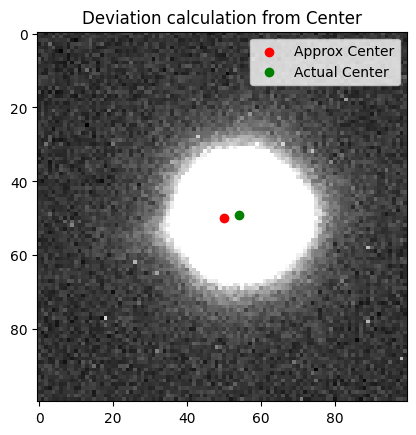

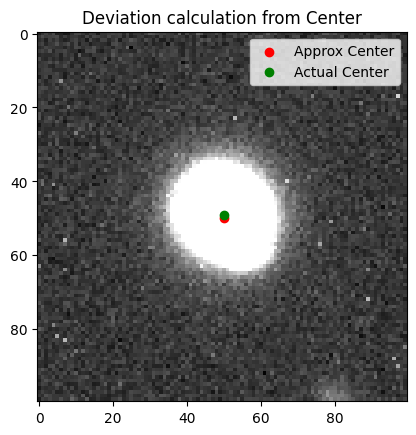

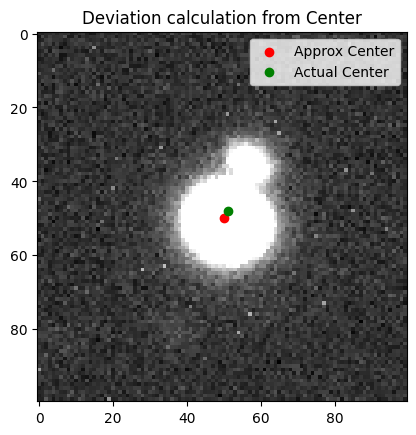

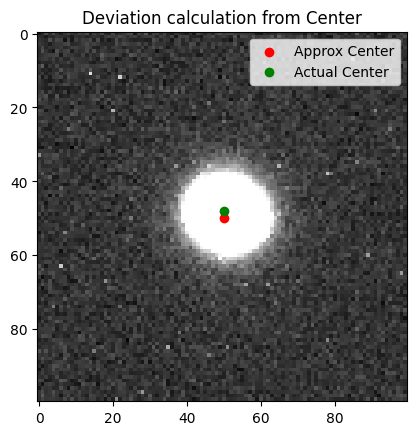

...

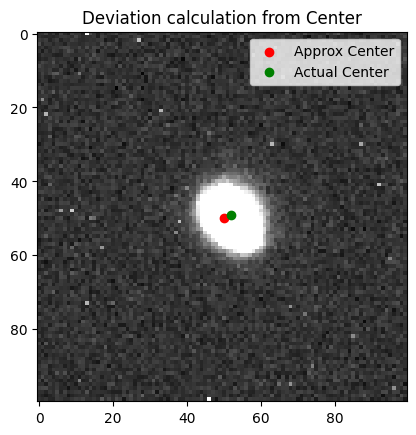

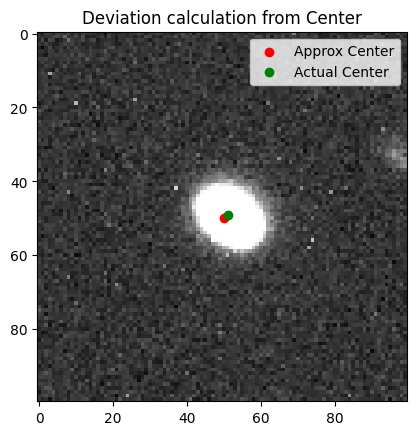

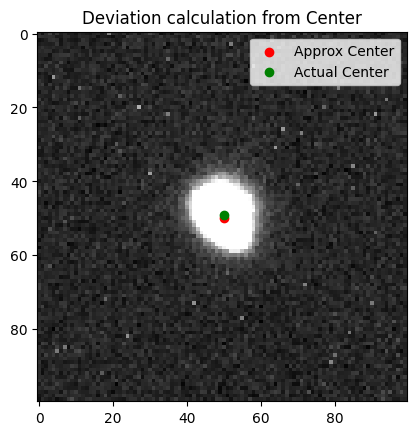

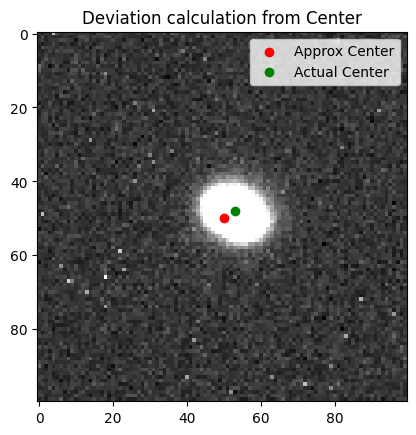

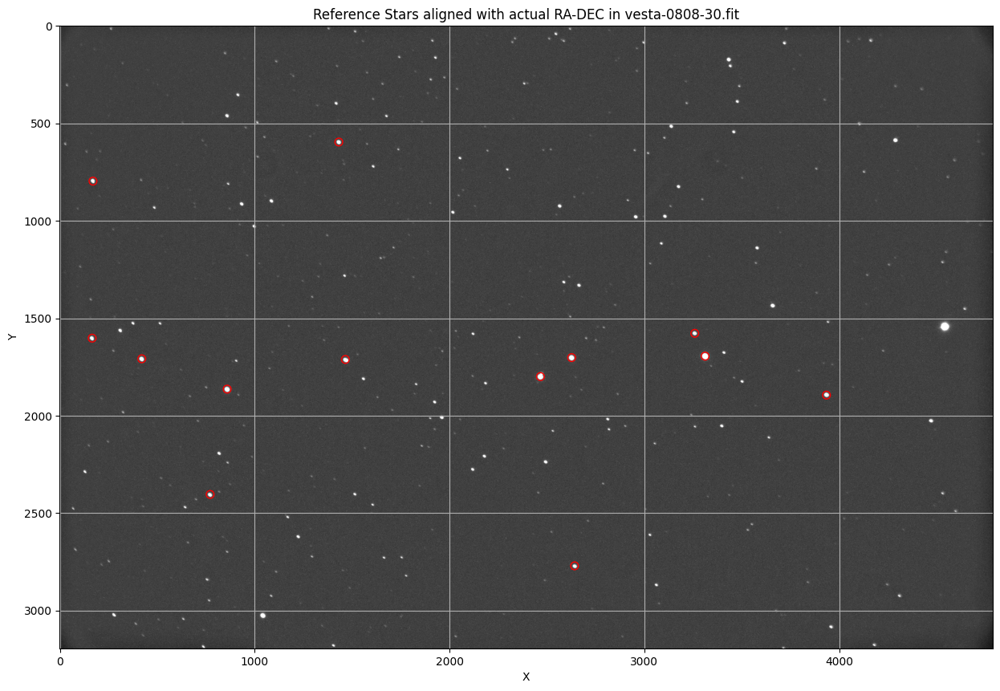

At Time 0808:
RA Vesta = 05:39:37.10
DEC Vesta = +24:00:41.97


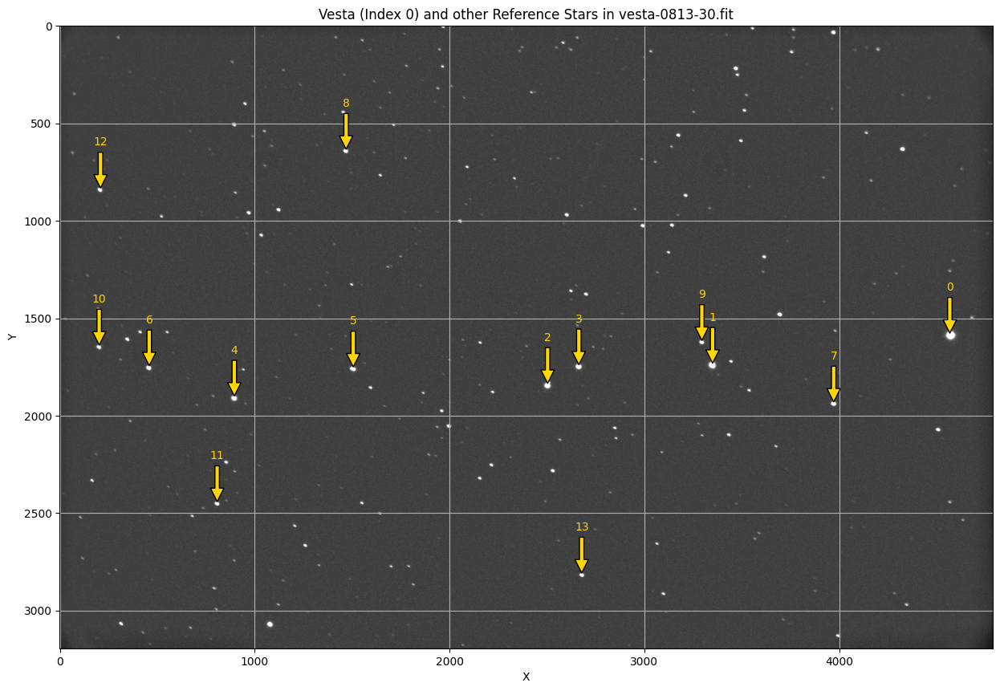

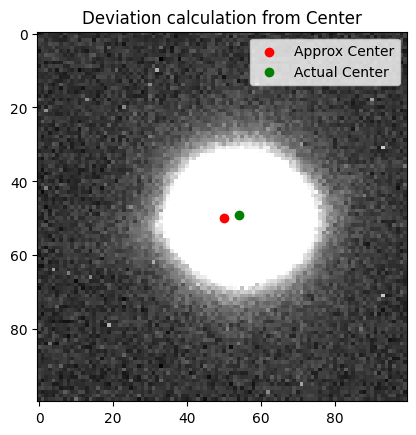

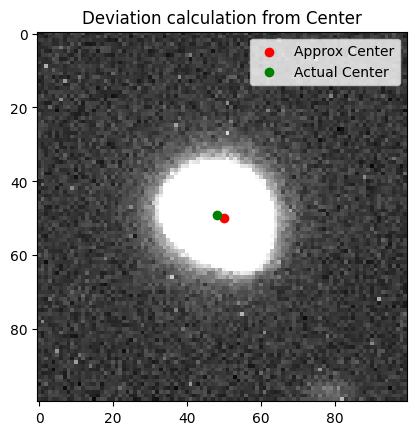

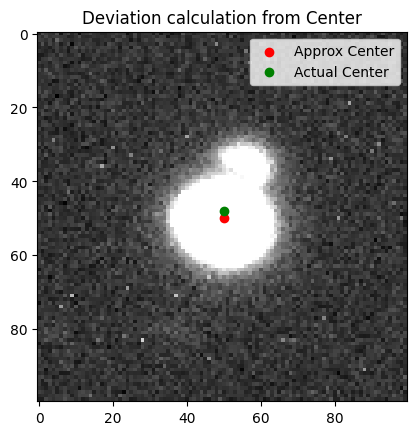

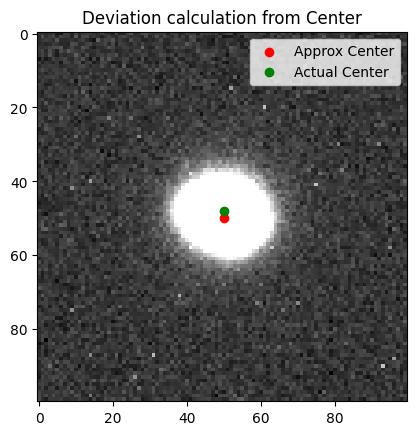

...

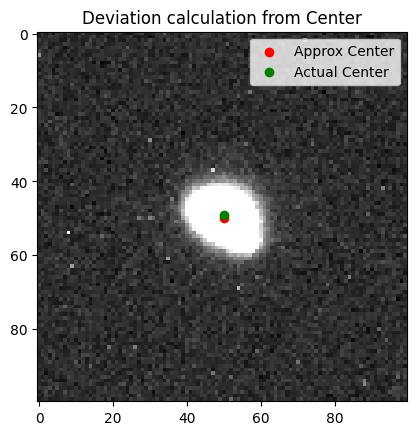

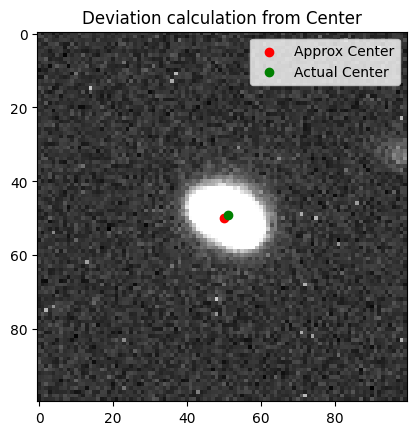

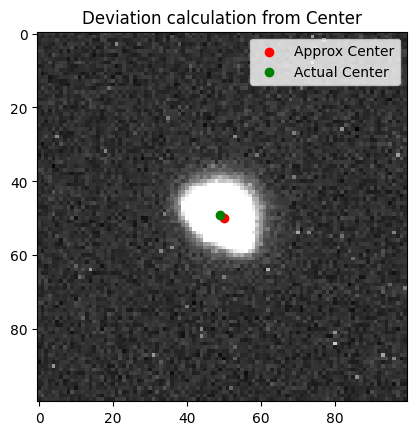

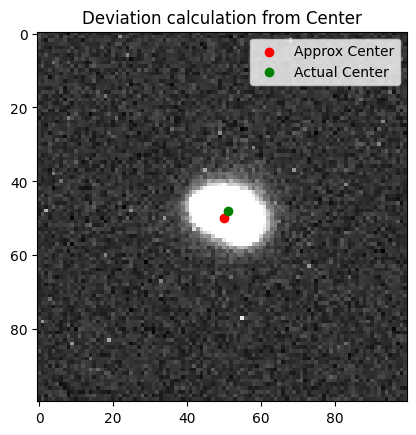

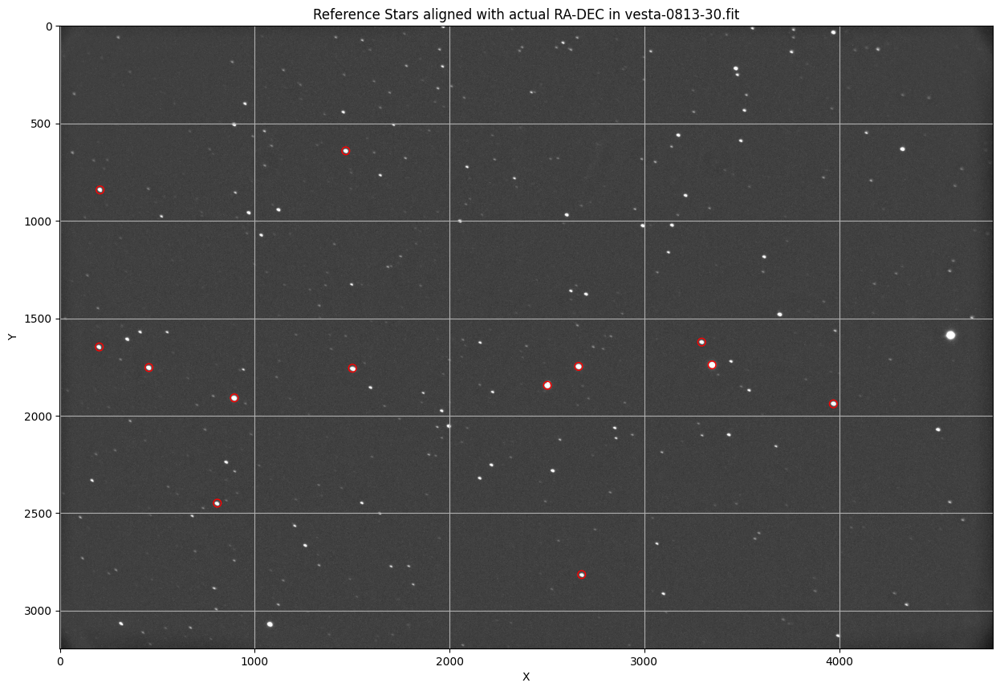

At Time 0813:
RA Vesta = 05:39:37.24
DEC Vesta = +24:00:42.27


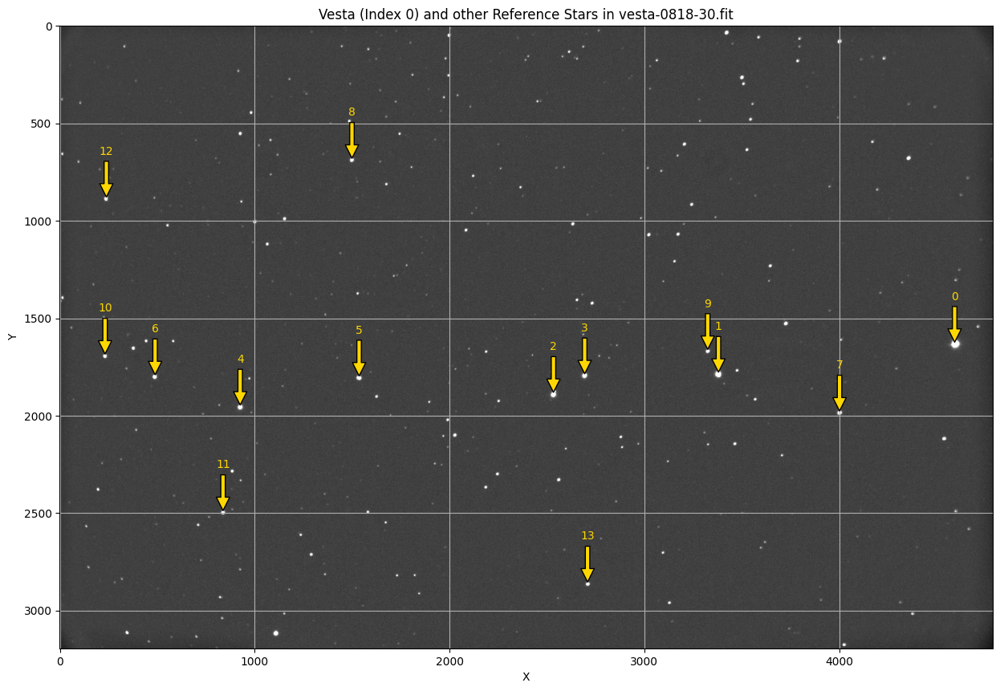

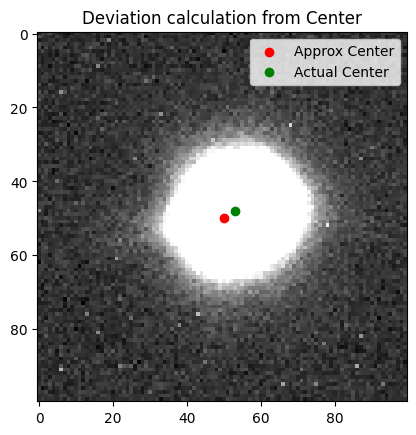

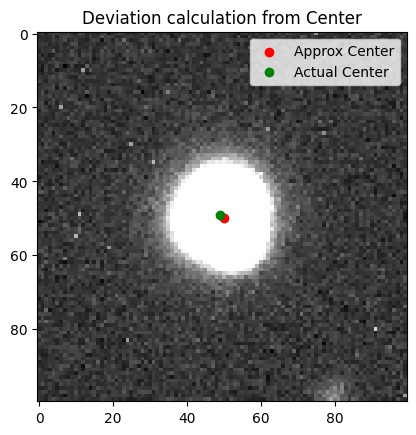

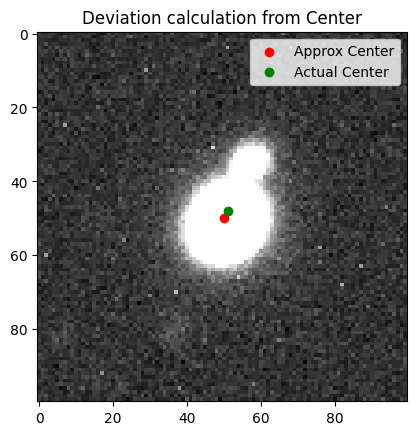

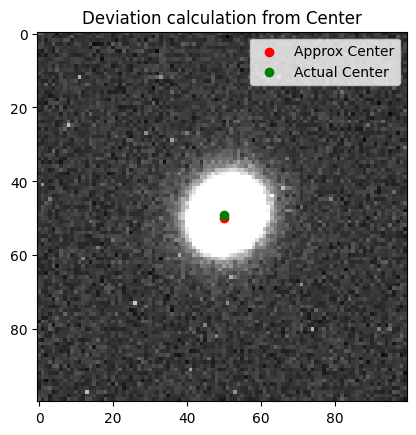

...

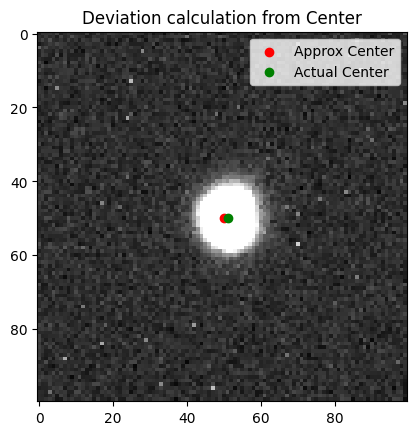

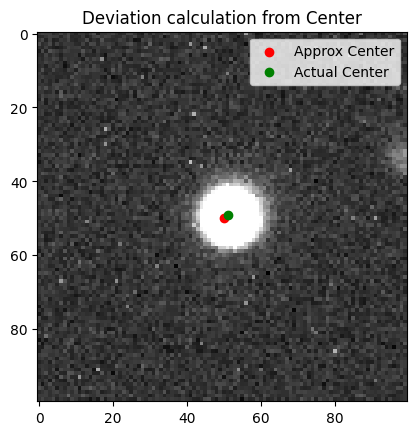

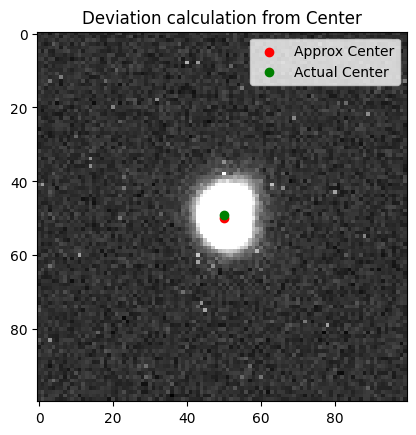

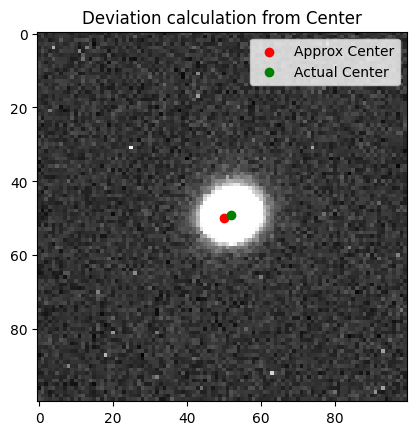

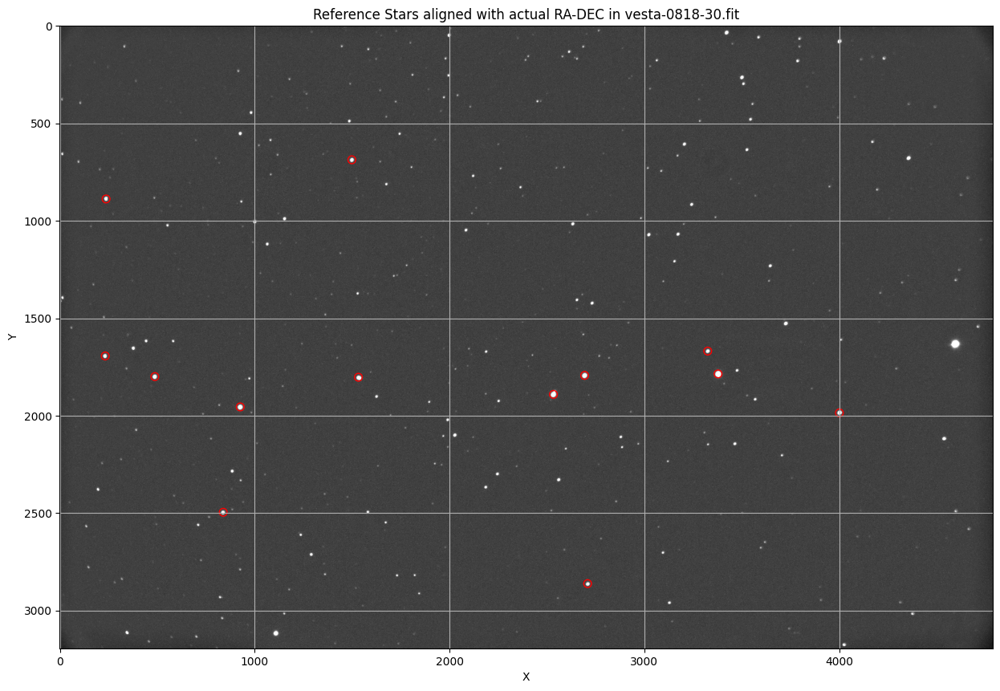

At Time 0818:
RA Vesta = 05:39:37.45
DEC Vesta = +24:00:42.43


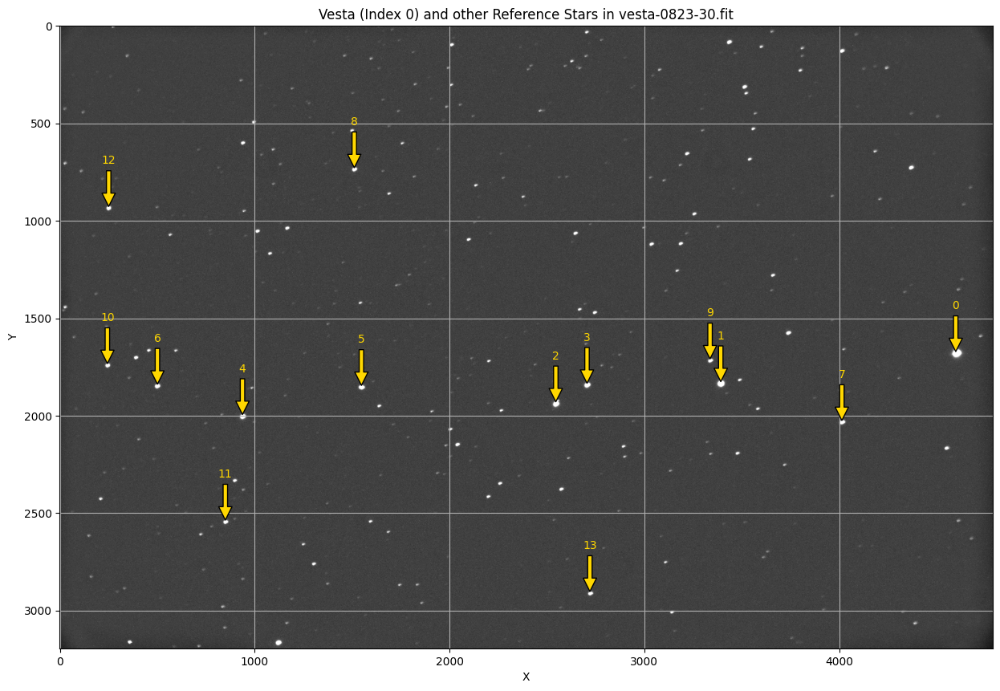

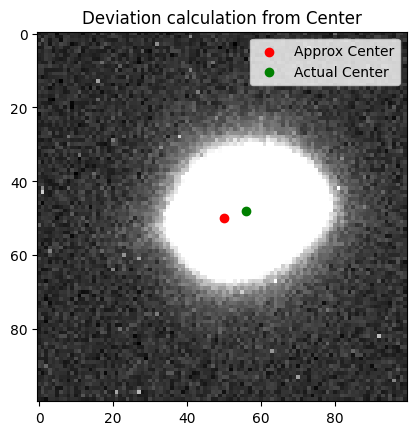

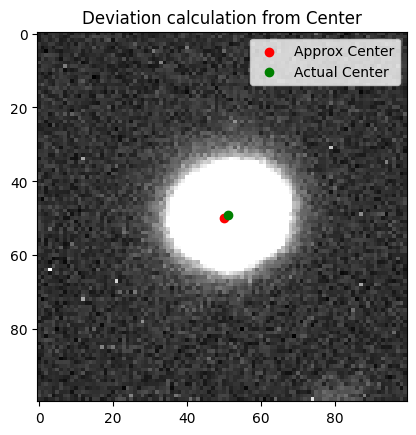

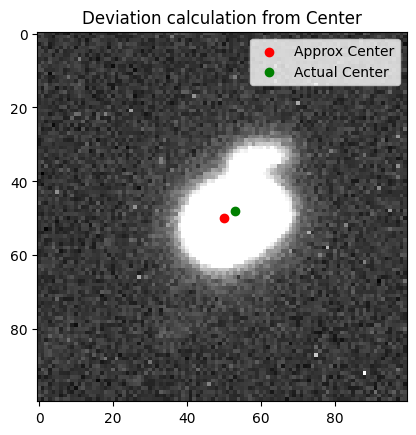

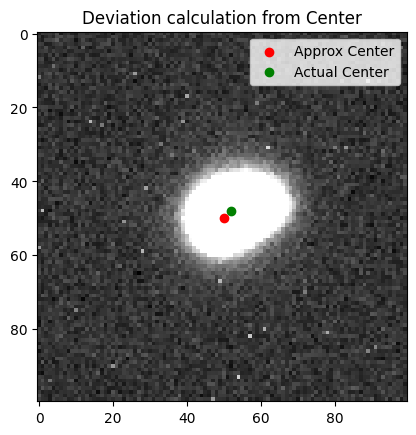

...

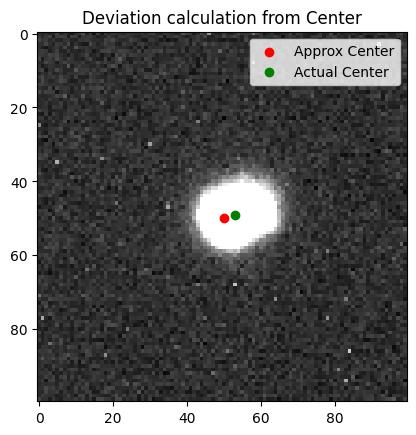

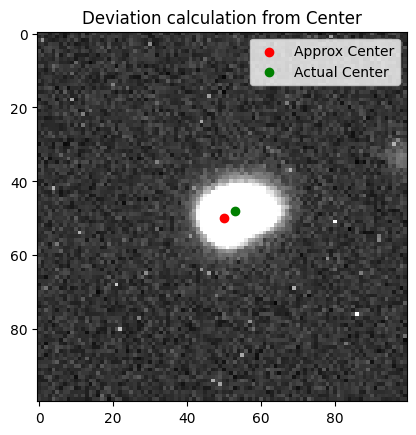

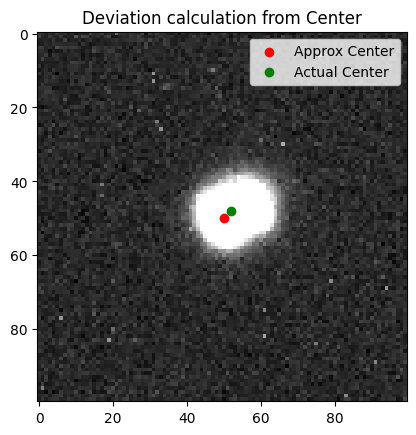

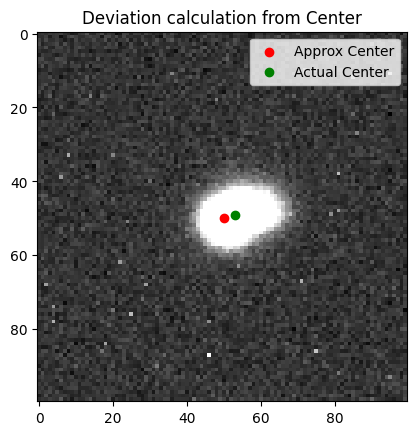

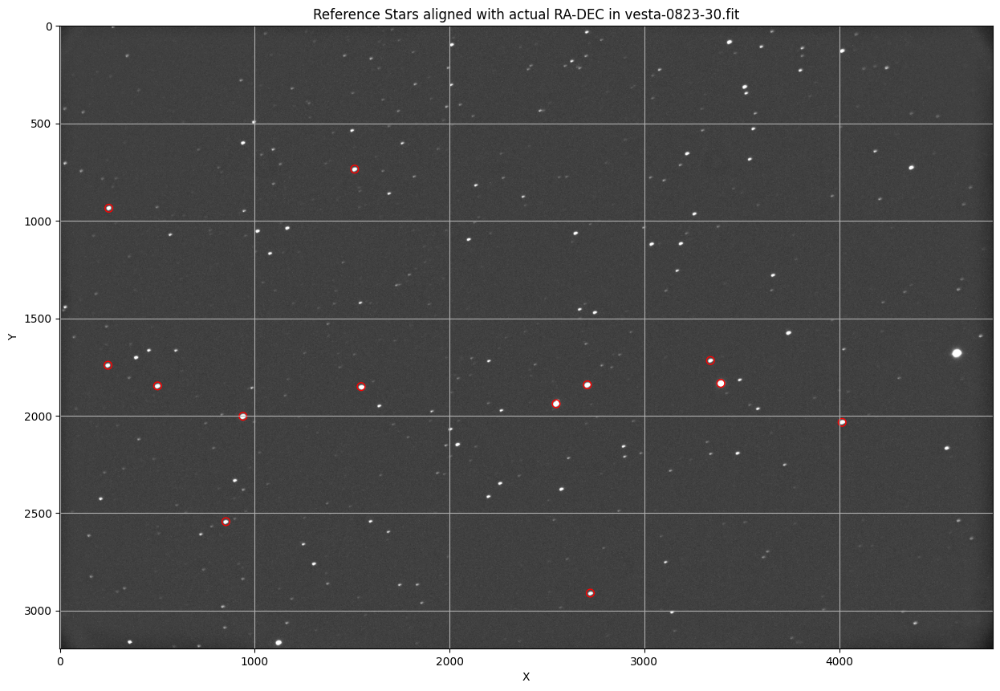

At Time 0823:
RA Vesta = 05:39:37.61
DEC Vesta = +24:00:42.77


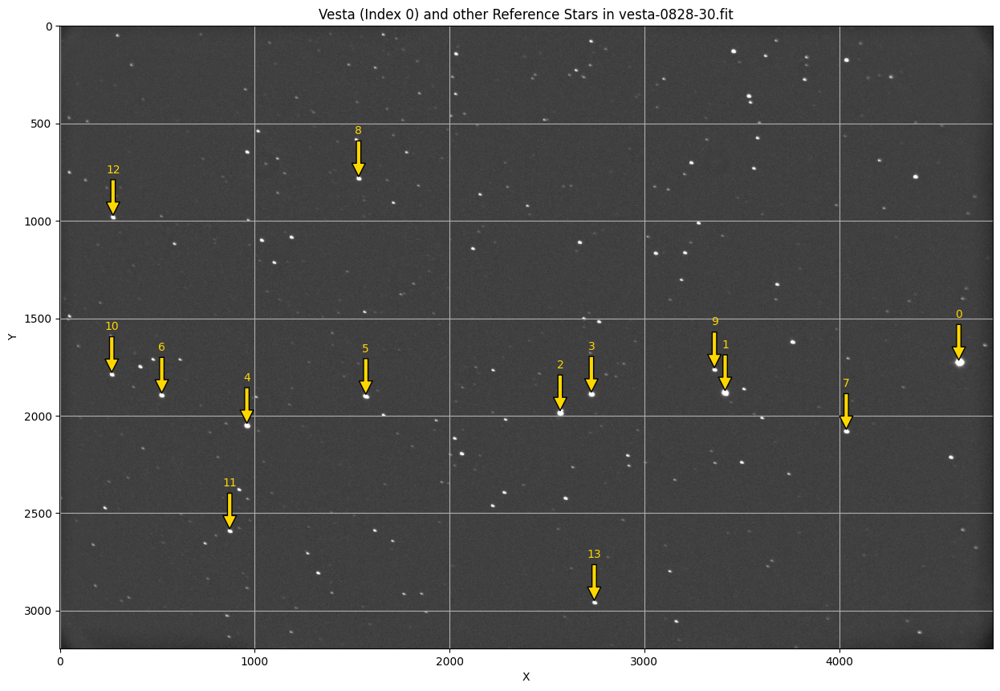

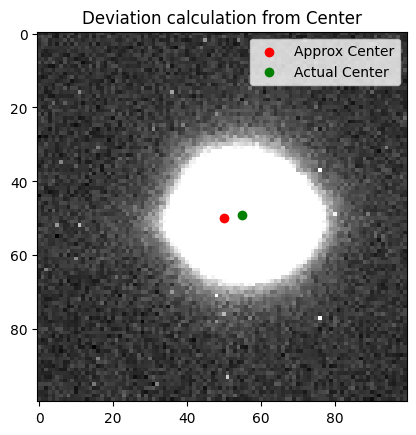

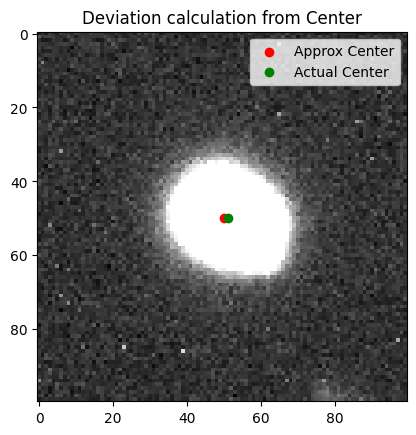

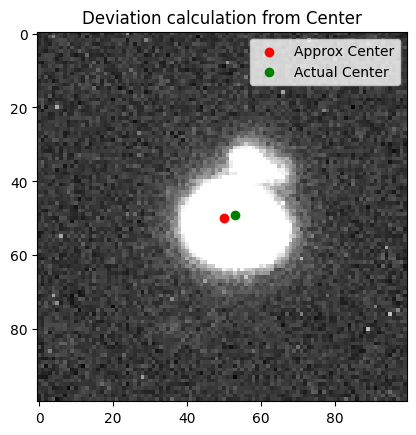

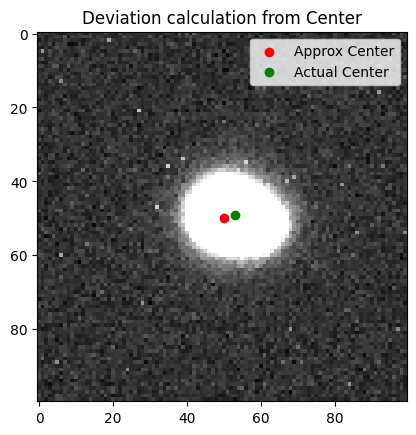

...

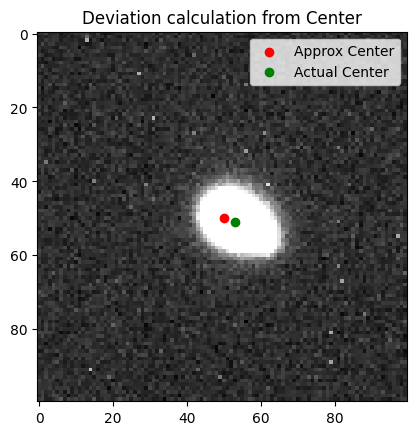

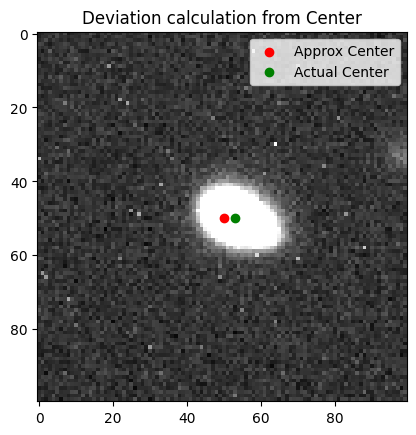

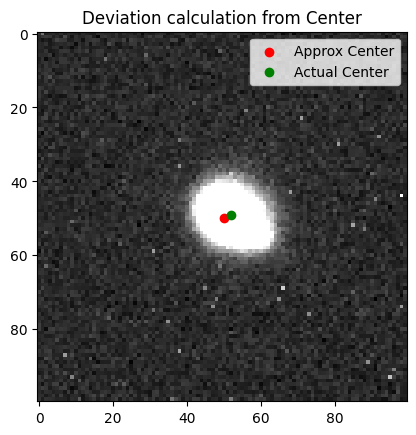

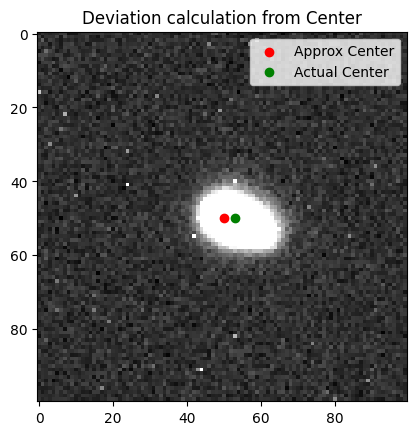

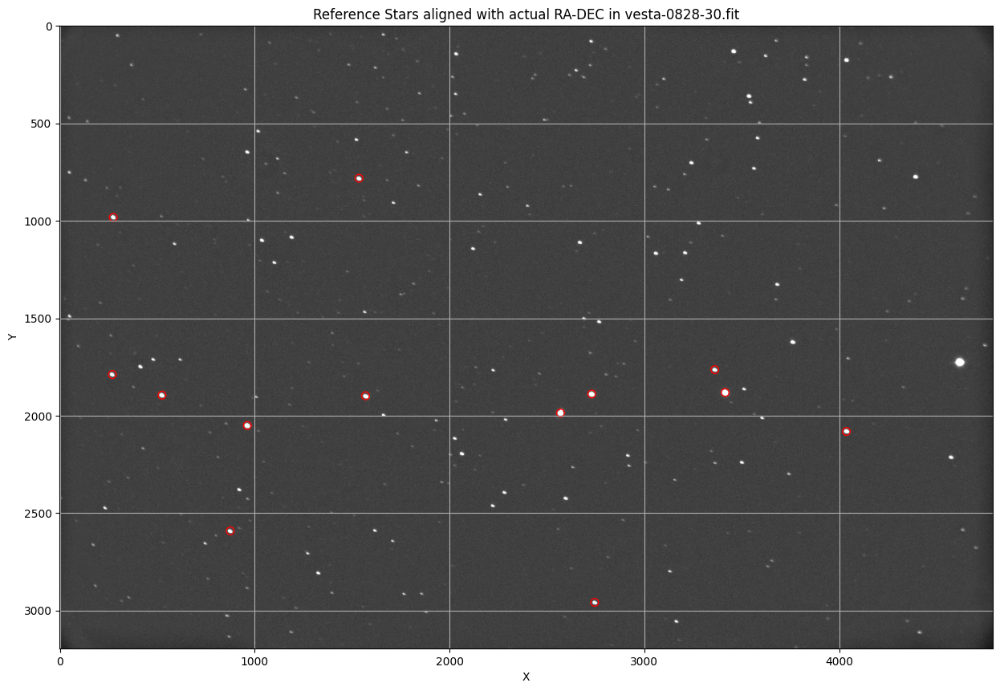

At Time 0828:
RA Vesta = 05:39:37.83
DEC Vesta = +24:00:43.22


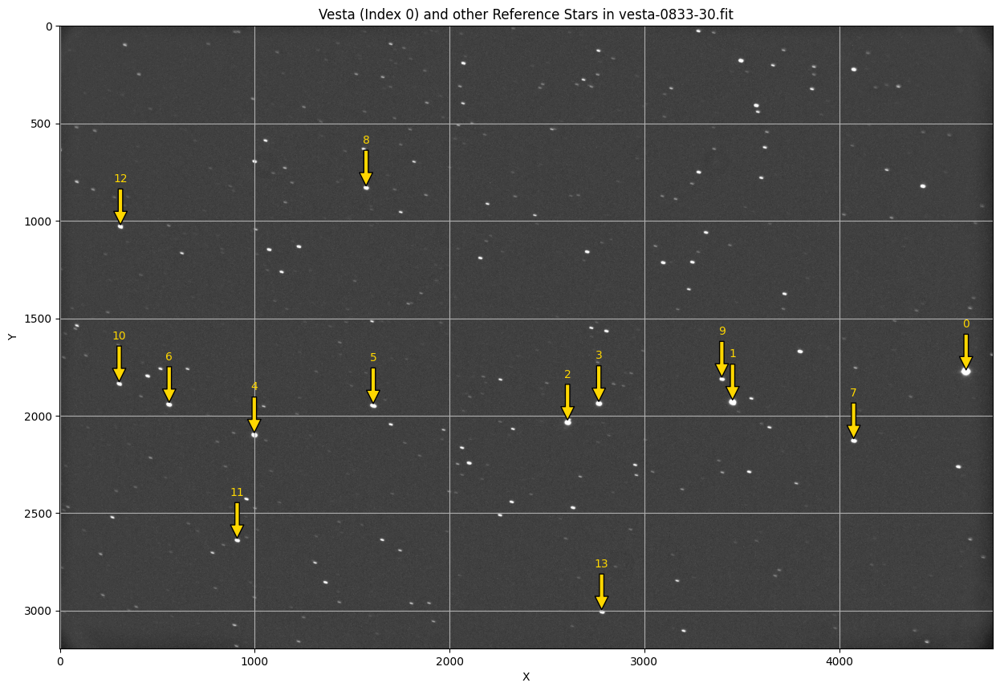

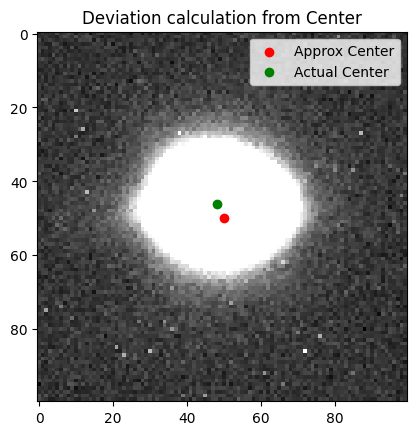

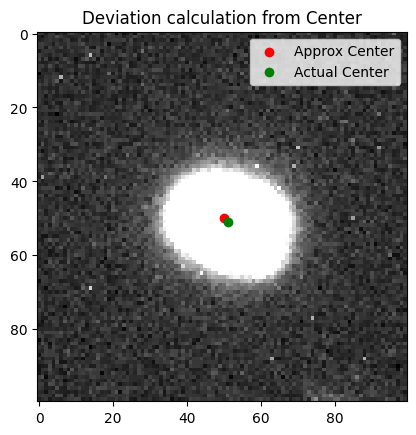

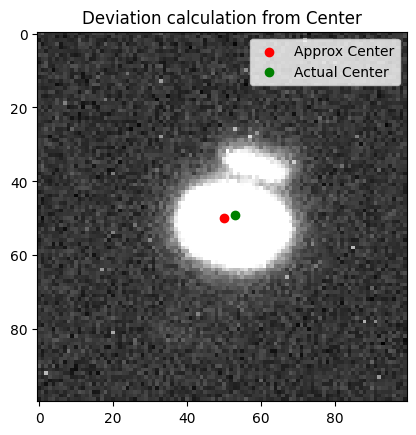

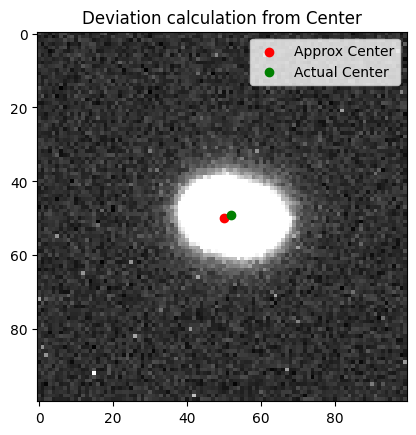

...

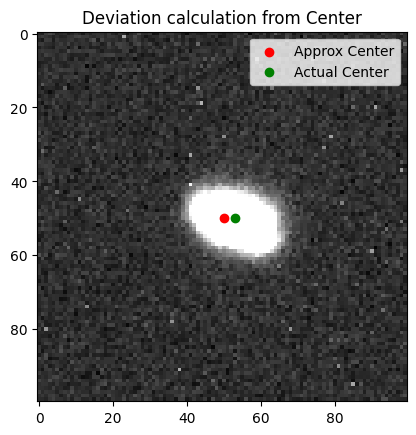

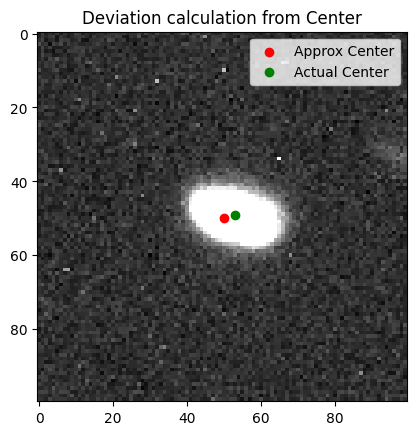

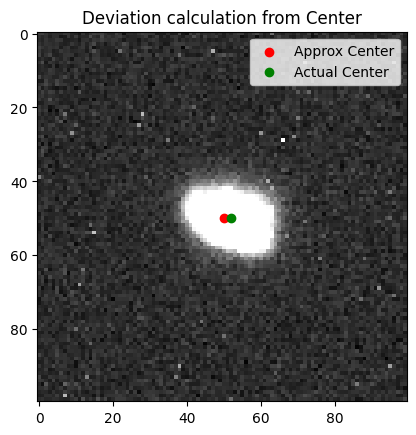

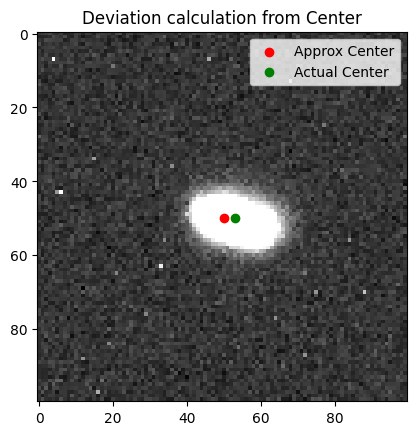

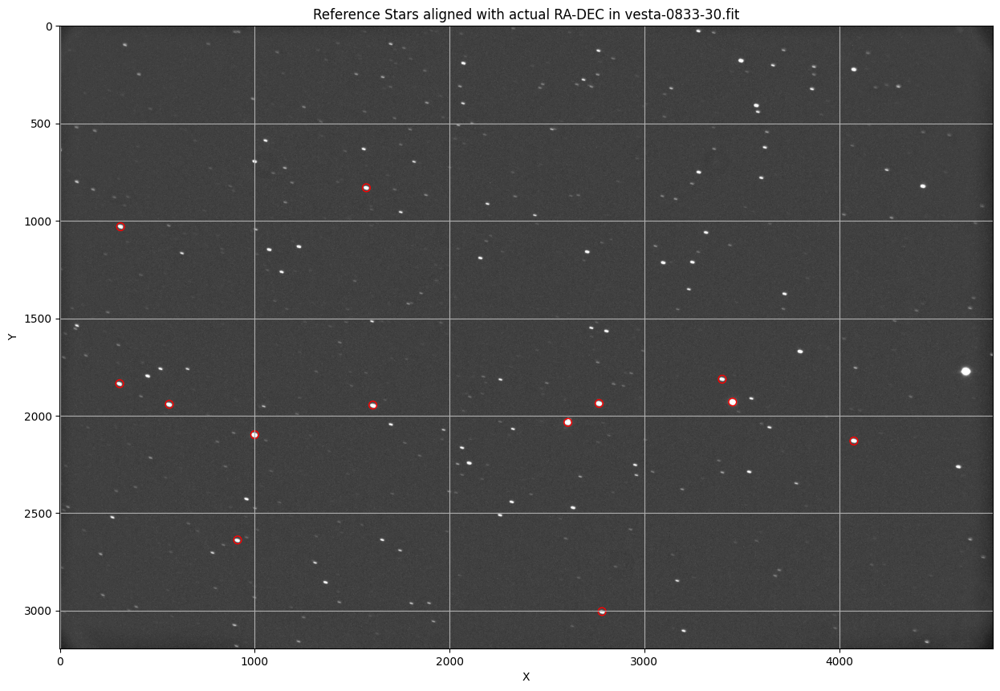

At Time 0833:
RA Vesta = 05:39:38.04
DEC Vesta = +24:00:44.29


In [ ]:
VestaTime=[]
VestaRA=[]# for plotting
VestaDEC=[]
VestaRA_hms=[]# for annotating
VestaDEC_dms=[]
WCSlog30={}
for id in range(len(files30)):
  fpath=dir+"/"+files30[id]
  Fname = fpath.split(" ")[-1]
  VestaTime.append(Fname.split('-')[-2]) # File name should be as: vesta-0831-10.fit
  fwhm=10
  # Read the FITS file
  hdulist = fits.open(f'{fpath}')
  data = hdulist[0].data
  hdulist.close()
  sigma_clip = SigmaClip(sigma=3.0)
  bkg_estimator = MedianBackground()
  boxsz=(50,50)
  bkg = Background2D(data, box_size=boxsz, filter_size=(3, 3), sigma_clip=sigma_clip, bkg_estimator=bkg_estimator)
  dataG=data-bkg.background
  # Calculate statistics of the image
  mean, median, std = sigma_clipped_stats(dataG)

  # Increase contrast using histogram equalization
  data_eq = (dataG - median) / std
  data_eq = np.clip(data_eq, -5, 15)  # Clip values to improve contrast
  data_eqG = (data_eq - np.min(data_eq)) / (np.max(data_eq) - np.min(data_eq))  # Normalize to [0, 1]

  mean, median, std = sigma_clipped_stats(dataG, sigma=3.0)
  daofind = DAOStarFinder(fwhm=fwhm, threshold=5.*std)
  sources = daofind(dataG - median)

  # Extract star positions
  positionsG = list(zip(sources['xcentroid'], sources['ycentroid']))
  # Plot found stars on the image
  aperturesG = CircularAperture(positionsG, r=15)

  phot_table = aperture_photometry(dataG, aperturesG)

  # Sort the table based on flux in descending order
  sorted_table = phot_table[np.argsort(phot_table['aperture_sum'])[::-1]]

  # Extract information for the top 20 brightest stars
  brightest_stars = sorted_table[:15]

  # Now brightest_stars contains information about the top 15 brightest stars, including their positions and fluxes

  # Extract x and y coordinates from the sorted table
  x_coords = brightest_stars['xcenter'].value  # Extracting only the values without units
  y_coords = brightest_stars['ycenter'].value

  StarRealPos=[]
  StarRealPos.append(['Vesta',0,0]) #RA and DEC to be Determined ### Index 0

  ## Real RA and DEC of Reference Stars obtained fro Gaia ESA Archive
  StarRealPos.append(['Gaia DR3 3404627761022008576',85.0495686636787,23.994702087345477])### Index 1
  StarRealPos.append(['Gaia DR3 3428458915343244160',85.14917489903979,23.983022077835393])### Index 2
  StarRealPos.append(['Gaia DR3 3428459125799366272',85.13033741414408,23.993581817388034])### Index 3
  StarRealPos.append(['Gaia DR3 3428457029855288320',85.33873967065942,23.975399810710655])### Index 4
  StarRealPos.append(['Gaia DR3 3428459808696441216',85.26727812859707,23.99208165675949])### Index 5
  StarRealPos.append(['Gaia DR3 3428456372722604288',85.3904759674444,23.991989198220498])### Index 6
  StarRealPos.append(['Gaia DR3 3404628035897721088',84.97604846875102,23.973421175690575])### Index 7
  StarRealPos.append(['Gaia DR3 3428461874579401984',85.27174123944212,24.112338583457138])### Index 8
  StarRealPos.append(['Gaia DR3 3428646966191271296',85.05588590466391,24.00730199704213])### Index 9
  StarRealPos.append(['Gaia DR3 3428462286895229952',85.42056399900392,24.003288247073453])### Index 10
  StarRealPos.append(['Gaia DR3 3428455483667075200',85.34879992600284,23.91710320114537])### Index 11
  StarRealPos.append(['Gaia DR3 3428463936162638592',85.42041082621621,24.09014937691221])### Index 12
  StarRealPos.append(['Gaia DR3 3404438297128229504',85.12806997923059,23.878414009697504])### Index 13

  # Corresponding approx Pixel Positions of Vesta and Reference stars calculated from one image
  # Need to be adjusted for each image (Done automatically using offSet Calculation)
  pixel_Positions=[[4640.6420766444435, 1751.0834620769394], # Approx Vesta Position X,Y
  [3441.8897960177396, 1908.4400578387736],
  [2595.2506588043793, 2011.7858683004401],
  [2755.425488957498, 1916.6541003918978],
  [987.3985388149332, 2077.0138224389775],
  [1597.7504670891947, 1927.6695306228723],
  [550.8075113129763, 1921.3460587236648],
  [4063.3013165199372, 2107.555199071425],
  [1561.0635654674124, 810.4360326193322],## Reference for alignment between images for offset calculation ## most separated
  [3386.796626879405, 1791.4358118228445],
  [294.01728125863735, 1815.328276225126],
  [899.3582586655771, 2618.6609221338185],
  [300.69285337972633, 1009.4283551293848],
  [2770.134021739819, 2985.096470278486]]

  offsetX = x_coords[0] - 1561.0635654674124
  offsetY = y_coords[0] - 810.4360326193322



  for i in range(len(brightest_stars)):
    if (offsetX**2+offsetY**2)>((x_coords[i]-1561.0635654674124)**2+(y_coords[i]-810.4360326193322)**2):
      offsetX = x_coords[i]-1561.0635654674124
      offsetY = y_coords[i]-810.4360326193322

  for i in range(14):
    pixel_Positions[i][0]+=offsetX
    pixel_Positions[i][1]+=offsetY

  offsetXvesta = x_coords[0] - pixel_Positions[0][0] ## Separate offset for vesta needed because it is moving relative to fixed stars
  offsetYvesta = y_coords[0] - pixel_Positions[0][1]

  for i in range(len(brightest_stars)):
    if (offsetXvesta**2+offsetYvesta**2)>((x_coords[i]-pixel_Positions[0][0])**2+(y_coords[i]-pixel_Positions[0][1])**2):
      offsetXvesta=x_coords[i]-pixel_Positions[0][0]
      offsetYvesta=y_coords[i]-pixel_Positions[0][1]

  pixel_Positions[0][0]+=offsetXvesta
  pixel_Positions[0][1]+=offsetYvesta
  #To find index of vesta:
  plt.figure(figsize=(15, 15))
  plt.imshow(data_eqG, cmap='gray')
  for i in range(14):
    plt.annotate(f'{i}', pixel_Positions[i], textcoords="offset points", xytext=(0,40), ha='center',color='gold',arrowprops=dict(facecolor='gold', shrink=0.05))
  plt.grid(True)
  plt.xlabel('X')
  plt.ylabel('Y')
  plt.title(f"Vesta (Index 0) and other Reference Stars in {Fname}")
  # plt.savefig(f"{fname}_StarDetect_G")
  plt.show()

  # Find real center of each star and astroid
  RealXY = [findRealCenter(data_eqG,pixel_Positions[i][0],pixel_Positions[i][1]) for i in range(14)]

  # Determining CD matrix using positions of known stars

  CRPIX=RealXY[1] # using 1st star as reference
  CRVAL=StarRealPos[1][1:]

  reference_stars = [
      {'RA': StarRealPos[i][1], 'Dec': StarRealPos[i][2], 'x': RealXY[i][0], 'y': RealXY[i][1]} for i in range(1, 14) #1 is used as reference star and only 5 stars used to fit
  ]

  # Convert reference stars to SkyCoord objects
  reference_coords = SkyCoord(ra=[star['RA'] for star in reference_stars] * u.deg,
                              dec=[star['Dec'] for star in reference_stars] * u.deg)

  # Pixel coordinates of reference stars
  pixel_coords = np.array([[star['x'], star['y']] for star in reference_stars])

  # Primary equation to form system of linear equations
  # RA - CRVAL[0] = CD1_1 * (x - CRPIX[0]) + CD1_2 * (y - CRPIX[1])
  # Dec -CRVAL[1] = CD2_1 * (x - CRPIX[0]) + CD2_2 * (y - CRPIX[1])

  # Construct the design matrix A for the linear equations
  A = np.vstack((pixel_coords[:, 0]- CRPIX[0], pixel_coords[:, 1]- CRPIX[1])).T

  # Target values (RA and Dec) for the linear equations
  b_ra = reference_coords.ra.deg-CRVAL[0]
  b_dec = reference_coords.dec.deg-CRVAL[1]

  # Solve the linear equations using least squares fitting separately for RA and Dec
  cd_matrix_ra, _, _, _ = np.linalg.lstsq(A, b_ra, rcond=None)
  cd_matrix_dec, _, _, _ = np.linalg.lstsq(A, b_dec, rcond=None)

  # Initialize a WCS object with specific dimensions
  wcs = WCS(naxis=2)

  # Set the CRVAL, CRPIX, and CD matrix
  wcs.wcs.crval = CRVAL  # RA, Dec
  wcs.wcs.crpix = CRPIX  # Reference pixel
  wcs.wcs.cd = np.array([cd_matrix_ra,
                        cd_matrix_dec])

  WCSlog30[Fname]=wcs # Save to dictionary

  pixel_x, pixel_y = RealXY[0]

  # Convert pixel coordinates to sky coordinates (RA, Dec)
  ra_dec_values = wcs.pixel_to_world(pixel_x, pixel_y)

  VestaRA.append(ra_dec_values[0])
  VestaDEC.append(ra_dec_values[1])
  VestaRA_hms.append(deg_to_hms_ra(float(ra_dec_values[0])))## in hour min sec
  VestaDEC_dms.append(deg_to_dms_dec(float(ra_dec_values[1])))
  StarRealPos[0][1:]=ra_dec_values

  RealPxlPos = [wcs.world_to_pixel_values(StarRealPos[i][1] * u.deg, StarRealPos[i][2] * u.deg) for i in range(1,14)]#

  plt.figure(figsize=(15, 15))
  plt.imshow(data_eqG, cmap='gray')
  for i in range(13): ## Excluding Vesta
      circle = plt.Circle((RealPxlPos[i][0], RealPxlPos[i][1]), radius=20, color='red', fill=False)
      plt.gca().add_patch(circle)
  plt.grid(True)
  plt.xlabel('X')
  plt.ylabel('Y')
  plt.title(f"Reference Stars aligned with actual RA-DEC in {Fname}")
  # plt.savefig(f"RefStars_30.jpg")
  plt.show()
  print(f"At Time {VestaTime[-1]}:\nRA Vesta = {VestaRA_hms[-1]}\nDEC Vesta = {VestaDEC_dms[-1]}")

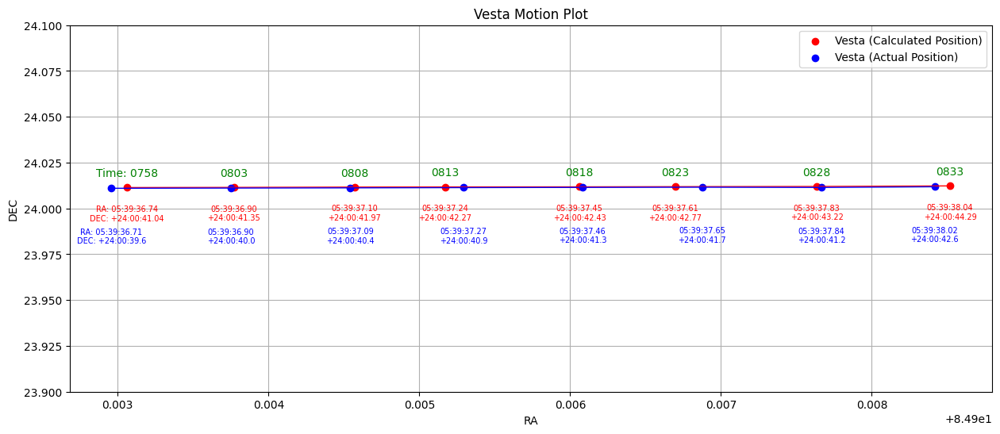

Average RA error: 1.82e-02 arcsec
Average DEC error: 1.45e+00 arcsec


In [ ]:
# import pickle

# # Save WCSlog to a pickle file
# with open('WCSlog30.pickle', 'wb') as f:
#     pickle.dump(WCSlog30, f)

actualRA = ["05:39:36.71", "05:39:36.90", "05:39:37.09", "05:39:37.27", "05:39:37.46", "05:39:37.65", "05:39:37.84", "05:39:38.02"]
actualDEC = ["+24:00:39.6", "+24:00:40.0", "+24:00:40.4", "+24:00:40.9", "+24:00:41.3", "+24:00:41.7", "+24:00:41.2", "+24:00:42.6"]
actualRAdeg = [float(hms_to_deg_ra(V)) for V in actualRA]
actualDECdeg = [float(dms_to_deg_dec(d)) for d in actualDEC]
plt.figure(figsize=(15, 6))
plt.scatter([float(V) for V in VestaRA], [float(d) for d in VestaDEC], color='red', label='Vesta (Calculated Position)')
plt.plot([float(V) for V in VestaRA], [float(d) for d in VestaDEC], color='red', linestyle='-', linewidth=1)

plt.scatter(actualRAdeg, actualDECdeg, color='blue', label='Vesta (Actual Position)')
plt.plot(actualRAdeg, actualDECdeg, color='blue', linestyle='-', linewidth=1)

# Annotate with VestaTime
for i in range(len(VestaTime)):
  ant = VestaTime[i]
  if i==0: ant="Time: "+ ant
  plt.annotate(ant, (float(VestaRA[i]), float(VestaDEC[i])), textcoords="offset points", xytext=(0, 10), ha='center', color='green')

# Annotate with VestaRA and VestaDEC
for i in range(len(VestaRA_hms)):
  ant = f'{VestaRA_hms[i]}\n{VestaDEC_dms[i]}'
  if i==0: ant=f'RA: {VestaRA_hms[i]}\nDEC: {VestaDEC_dms[i]}'
  plt.annotate(ant, (float(VestaRA[i]), float(VestaDEC[i])), textcoords="offset points", xytext=(0, -30), ha='center', color='red',fontsize=7)

# Annotate with actual Positions
for i in range(len(actualRA)):
  ant = f'{actualRA[i]}\n{actualDEC[i]}'
  if i==0: ant=f'RA: {actualRA[i]}\nDEC: {actualDEC[i]}'
  plt.annotate(ant, (float(hms_to_deg_ra(actualRA[i])), float(dms_to_deg_dec(actualDEC[i]))), textcoords="offset points", xytext=(0, -50), ha='center', color='blue',fontsize=7)

plt.xlabel('RA')
plt.ylabel('DEC')
plt.title('Vesta Motion Plot')
plt.ylim(23.9,24.1)
plt.legend()
plt.grid(True)
plt.show()

# Calculate error between actual and calculated positions
ra_error = np.abs(np.array(actualRAdeg) - np.array([float(V) for V in VestaRA]))
dec_error = np.abs(np.array(actualDECdeg) - np.array([float(d) for d in VestaDEC]))

# Calculate average error in RA and DEC
average_ra_error = np.mean(ra_error)
average_dec_error = np.mean(dec_error)

print(f"Average RA error: {average_ra_error/15*3600:.2e} arcsec")
print(f"Average DEC error: {average_dec_error*3600:.2e} arcsec")

In [ ]:
WCSlog30

{'vesta-0758-30.fit': WCS Keywords
 
 Number of WCS axes: 2
 CTYPE : ''  ''  
 CRVAL : 85.0495686636787  23.994702087345477  
 CRPIX : 3261.465914488423  1608.698518255676  
 CD1_1 CD1_2  : -0.00011791311113318319  -3.9587631734886937e-07  
 CD2_1 CD2_2  : 4.1099420502725054e-07  -0.00010778658568653177  
 NAXIS : 0  0,
 'vesta-0803-30.fit': WCS Keywords
 
 Number of WCS axes: 2
 CTYPE : ''  ''  
 CRVAL : 85.0495686636787  23.994702087345477  
 CRPIX : 3280.7370149267645  1652.6218188953817  
 CD1_1 CD1_2  : -0.00011791023287626446  -4.334117379208363e-07  
 CD2_1 CD2_2  : 4.2696930222260796e-07  -0.0001078189260600237  
 NAXIS : 0  0,
 'vesta-0808-30.fit': WCS Keywords
 
 Number of WCS axes: 2
 CTYPE : ''  ''  
 CRVAL : 85.0495686636787  23.994702087345477  
 CRPIX : 3312.6935095695744  1695.489628005953  
 CD1_1 CD1_2  : -0.00011791961577447203  -4.5934343503429854e-07  
 CD2_1 CD2_2  : 4.3666683887853307e-07  -0.00010779047129957387  
 NAXIS : 0  0,
 'vesta-0813-30.fit': WCS Keyword